## 로지스틱 회귀 분석

In [128]:
# 데이터 구성:Series, DataFrame
import pandas as pd
# 행렬 연산
import numpy as np
# 데이터 시각화
import matplotlib.pyplot as plt
import matplotlib
# scaling
from sklearn.preprocessing import StandardScaler
# 데이터 분할:train, test
from sklearn.model_selection import train_test_split
# 로지스틱 회귀
from statsmodels.api import Logit
# 분류모델 평가 함수
from sklearn.metrics import accuracy_score, f1_score 
from sklearn.metrics import confusion_matrix, classification_report

In [129]:
plt.rcParams['font.family'] = 'NanumGothic'
matplotlib.rcParams['axes.unicode_minus'] = False

In [130]:
df_raw = pd.read_csv("../실습파일/2. Big Data 분석/통신고객이탈.csv")
df_raw.head()

,CHURN,CUSTOMER_ID,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,Active,K102990,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,Active,K103280,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,Active,K103660,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,Active,K103730,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,Active,K104560,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


In [131]:
display(df_raw.info())
print("Data 구조", df_raw.shape)
print("변수: ", df_raw.columns)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 930 entries, 0 to 929
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   CHURN               930 non-null    object 
 1   CUSTOMER_ID         930 non-null    object 
 2   GENDER              930 non-null    object 
 3   AGE                 930 non-null    int64  
 4   CHARGE_TYPE         930 non-null    object 
 5   HANDSET             930 non-null    object 
 6   USAGE_BAND          930 non-null    object 
 7   SERVICE_DURATION    930 non-null    float64
 8   DROPPED_CALLS       930 non-null    int64  
 9   PEAK_CALLS_NO       930 non-null    int64  
 10  PEAK_CALLS_TIME     930 non-null    float64
 11  WEEKEND_CALLS_NO    930 non-null    int64  
 12  WEEKEND_CALLS_TIME  930 non-null    float64
 13  TOTAL_CALLS_NO      930 non-null    int64  
 14  TOTAL_CALLS_TIME    930 non-null    float64
dtypes: float64(4), int64(5), object(6)
memory usage: 109.1+ K

None

Data 구조 (930, 15)
변수:  Index(['CHURN', 'CUSTOMER_ID', 'GENDER', 'AGE', 'CHARGE_TYPE', 'HANDSET',
       'USAGE_BAND', 'SERVICE_DURATION', 'DROPPED_CALLS', 'PEAK_CALLS_NO',
       'PEAK_CALLS_TIME', 'WEEKEND_CALLS_NO', 'WEEKEND_CALLS_TIME',
       'TOTAL_CALLS_NO', 'TOTAL_CALLS_TIME'],
      dtype='object')


In [132]:
df_raw.isnull().sum(axis = 0)

CHURN                 0
CUSTOMER_ID           0
GENDER                0
AGE                   0
CHARGE_TYPE           0
HANDSET               0
USAGE_BAND            0
SERVICE_DURATION      0
DROPPED_CALLS         0
PEAK_CALLS_NO         0
PEAK_CALLS_TIME       0
WEEKEND_CALLS_NO      0
WEEKEND_CALLS_TIME    0
TOTAL_CALLS_NO        0
TOTAL_CALLS_TIME      0
dtype: int64

결측치 확인 결과 존재하지 않았음

In [133]:
# 명목형 변수 목록
obj_cols = df_raw.select_dtypes("object").columns

for col in obj_cols:
    _n = len(df_raw[col].value_counts())
    print(col, ":", str(_n))

CHURN : 2
CUSTOMER_ID : 930
GENDER : 2
CHARGE_TYPE : 5
HANDSET : 11
USAGE_BAND : 6


In [134]:
df_raw["CHURN"] = df_raw["CHURN"].replace({"Active": 0, "Churned": 1})
df_raw['GENDER'] = df_raw['GENDER'].replace({'M': 0, 'F': 1})

CHURN과 GENDER에 대해 0,1로 이진화하여 데이터 변경

In [136]:
df_train, df_test = train_test_split(df_raw, # 데이터
                                     test_size = 0.3, # test 데이터의 비율
                                     random_state = 100)  # random state

print("train data size : {}".format(df_train.shape))
print("test data size : {}".format(df_test.shape))

train data size : (651, 15)
test data size : (279, 15)


In [137]:
df_raw

,CHURN,CUSTOMER_ID,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,0,K102990,1,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,0,K103280,0,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,0,K103660,0,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,0,K103730,0,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,0,K104560,1,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
925,1,K413330,0,19,Play 100,SOP10,Med,17.40,12,60,100.8,27,59.4,127,628.2
926,1,K413410,1,59,Play 100,SOP20,Med,17.37,15,82,130.2,12,25.8,357,650.7
927,1,K415490,1,33,Play 300,S50,Med,44.93,12,174,286.2,25,67.0,596,1039.0
928,1,K415880,1,25,Play 300,S50,Med,40.43,14,315,552.0,0,0.0,609,1188.3


In [138]:
log_model = Logit.from_formula("""CHURN ~ AGE + GENDER + C(CHARGE_TYPE) + C(USAGE_BAND) + C(HANDSET)\
                                + SERVICE_DURATION + DROPPED_CALLS + PEAK_CALLS_NO + PEAK_CALLS_TIME + WEEKEND_CALLS_NO\
                               + WEEKEND_CALLS_TIME + TOTAL_CALLS_NO + TOTAL_CALLS_TIME""", df_train)
# 적합
log_result = log_model.fit()

# 결과 출력
print(log_result.summary())

         Current function value: 0.255832
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:                  CHURN   No. Observations:                  651
Model:                          Logit   Df Residuals:                      621
Method:                           MLE   Df Model:                           29
Date:                Thu, 07 Mar 2024   Pseudo R-squ.:                  0.4988
Time:                        16:04:13   Log-Likelihood:                -166.55
converged:                      False   LL-Null:                       -332.31
Covariance Type:            nonrobust   LLR p-value:                 4.440e-53
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept                    -25.5622   3966.550     -0.006      0.995   -7799.857    7748.732
C(CHARGE_TYPE)[T.

/home/piai/anaconda3/lib/python3.10/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


p-value가 0.05가 넘는 CHARGE_TYPE 먼저 삭제

In [145]:
log_model = Logit.from_formula("""CHURN ~ AGE + GENDER + C(USAGE_BAND) + C(HANDSET)\
                                + SERVICE_DURATION + DROPPED_CALLS + PEAK_CALLS_NO + PEAK_CALLS_TIME + WEEKEND_CALLS_NO\
                               + WEEKEND_CALLS_TIME + TOTAL_CALLS_NO + TOTAL_CALLS_TIME""", df_train)
# 적합
log_result = log_model.fit()

# 결과 출력
print(log_result.summary())

         Current function value: 0.275367
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:                  CHURN   No. Observations:                  651
Model:                          Logit   Df Residuals:                      625
Method:                           MLE   Df Model:                           25
Date:                Thu, 07 Mar 2024   Pseudo R-squ.:                  0.4605
Time:                        16:16:52   Log-Likelihood:                -179.26
converged:                      False   LL-Null:                       -332.31
Covariance Type:            nonrobust   LLR p-value:                 3.606e-50
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
Intercept                  -20.5601   1008.608     -0.020      0.984   -1997.395    1956.274
C(USAGE_BAND)[T.Low]   

/home/piai/anaconda3/lib/python3.10/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


다음으로 p-value가 0.05가 넘는 HANDSET 삭제

In [146]:
log_model = Logit.from_formula("""CHURN ~ AGE + GENDER + C(USAGE_BAND)\
                                + SERVICE_DURATION + DROPPED_CALLS + PEAK_CALLS_NO + PEAK_CALLS_TIME + WEEKEND_CALLS_NO\
                               + WEEKEND_CALLS_TIME + TOTAL_CALLS_NO + TOTAL_CALLS_TIME""", df_train)
# 적합
log_result = log_model.fit()

# 결과 출력
print(log_result.summary())

         Current function value: 0.464041
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:                  CHURN   No. Observations:                  651
Model:                          Logit   Df Residuals:                      635
Method:                           MLE   Df Model:                           15
Date:                Thu, 07 Mar 2024   Pseudo R-squ.:                 0.09093
Time:                        16:18:36   Log-Likelihood:                -302.09
converged:                      False   LL-Null:                       -332.31
Covariance Type:            nonrobust   LLR p-value:                 2.126e-07
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
Intercept                   -3.2282      1.321     -2.444      0.015      -5.817      -0.640
C(USAGE_BAND)[T.Low]   

/home/piai/anaconda3/lib/python3.10/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


p-value가 0.05를 크게 상회하는 GENDER, SERVICE_DURATION, WEEKEND_CALLS_TIME, TOTAL_CALLS_NO 삭제

In [147]:
log_model = Logit.from_formula("""CHURN ~ AGE + C(USAGE_BAND)\
                                + DROPPED_CALLS + PEAK_CALLS_NO + PEAK_CALLS_TIME + WEEKEND_CALLS_NO\
                                + TOTAL_CALLS_TIME""", df_train)
# 적합
log_result = log_model.fit()

# 결과 출력
print(log_result.summary())

         Current function value: 0.465316
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:                  CHURN   No. Observations:                  651
Model:                          Logit   Df Residuals:                      639
Method:                           MLE   Df Model:                           11
Date:                Thu, 07 Mar 2024   Pseudo R-squ.:                 0.08843
Time:                        16:20:30   Log-Likelihood:                -302.92
converged:                      False   LL-Null:                       -332.31
Covariance Type:            nonrobust   LLR p-value:                 1.567e-08
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
Intercept                   -3.2067      1.290     -2.485      0.013      -5.736      -0.678
C(USAGE_BAND)[T.Low]   

/home/piai/anaconda3/lib/python3.10/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


p-value가 0.05가 넘는 값들 중 수치가 큰 PEAK_CALLS_NO, PEAK_CALLS_TIME, WEEKEND_CALLS_NO 삭제 <br>
p-value가 0.05를 크게 넘지 않는 TOTAL_CALLS_TIME은 삭제하지 않고 진행

In [151]:
log_model = Logit.from_formula("""CHURN ~ AGE + C(USAGE_BAND) + TOTAL_CALLS_TIME\
                                + DROPPED_CALLS""", df_train)
# 적합
log_result = log_model.fit()

# 결과 출력
print(log_result.summary())

         Current function value: 0.465636
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:                  CHURN   No. Observations:                  651
Model:                          Logit   Df Residuals:                      642
Method:                           MLE   Df Model:                            8
Date:                Thu, 07 Mar 2024   Pseudo R-squ.:                 0.08780
Time:                        16:23:52   Log-Likelihood:                -303.13
converged:                      False   LL-Null:                       -332.31
Covariance Type:            nonrobust   LLR p-value:                 9.787e-10
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
Intercept                   -3.3147      1.273     -2.604      0.009      -5.810      -0.820
C(USAGE_BAND)[T.Low]   

/home/piai/anaconda3/lib/python3.10/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


모든 변수가 유의한 조건 달성됨

In [152]:
# train 데이터 예측
y_pred_train = log_result.predict(df_train)
# 0과 1의 값을 가진 class로 변환
y_pred_train_class = (y_pred_train > 0.5).astype(int)  # 0.5 : “1/0” 판정 임계값(1 발생 확률) 변경 가능 
print("Train 예측 결과 \n", y_pred_train_class.head(), "\n")
print("Confusion Matrix: \n{}".format(confusion_matrix(df_train["CHURN"],y_pred_train_class)),"\n")

# test 데이터 예측
y_pred_test = log_result.predict(df_test)
# 0과 1의 값을 가진 class로 변환
y_pred_test_class = (y_pred_test > 0.5).astype(int)
print("Test 예측 결과 \n", y_pred_test_class.head(),"\n")
print("Confusion Matrix: \n{}".format(confusion_matrix(df_test["CHURN"],y_pred_test_class)),"\n")

Train 예측 결과 
 517    0
111    0
432    0
105    0
511    0
dtype: int64 

Confusion Matrix: 
[[508   8]
 [121  14]] 

Test 예측 결과 
 372    0
117    0
299    0
133    0
766    0
dtype: int64 

Confusion Matrix: 
[[228   6]
 [ 41   4]] 



In [154]:
print("Train 예측/분류 결과")
print("Accuracy: {0:.3f}\n".format(accuracy_score(df_train["CHURN"], y_pred_train_class)))
print("Confusion Matrix: \n{}".format(confusion_matrix(df_train["CHURN"],y_pred_train_class)),"\n")
print(classification_report(df_train["CHURN"], y_pred_train_class, digits=3))

# 실제 train 데이터와 예측 결과 비교
print("Test 예측/분류 결과")
print("Accuracy: {0:.3f}\n".format(accuracy_score(df_test["CHURN"], y_pred_test_class)))
print("Confusion Matrix: \n{}".format(confusion_matrix(df_test["CHURN"],y_pred_test_class)),"\n")
print(classification_report(df_test["CHURN"], y_pred_test_class, digits=3))

Train 예측/분류 결과
Accuracy: 0.802

Confusion Matrix: 
[[508   8]
 [121  14]] 

              precision    recall  f1-score   support

           0      0.808     0.984     0.887       516
           1      0.636     0.104     0.178       135

    accuracy                          0.802       651
   macro avg      0.722     0.544     0.533       651
weighted avg      0.772     0.802     0.740       651

Test 예측/분류 결과
Accuracy: 0.832

Confusion Matrix: 
[[228   6]
 [ 41   4]] 

              precision    recall  f1-score   support

           0      0.848     0.974     0.907       234
           1      0.400     0.089     0.145        45

    accuracy                          0.832       279
   macro avg      0.624     0.532     0.526       279
weighted avg      0.775     0.832     0.784       279



In [156]:
print("Train 예측/분류 결과")

print(classification_report(df_test["CHURN"], y_pred_test_class, target_names=['Active', 'Churned'], digits=3))

print("Test 예측/분류 결과")

print(classification_report(df_test["CHURN"], y_pred_test_class, target_names=['Active', 'Churned'], digits=3))

Train 예측/분류 결과
              precision    recall  f1-score   support

      Active      0.848     0.974     0.907       234
     Churned      0.400     0.089     0.145        45

    accuracy                          0.832       279
   macro avg      0.624     0.532     0.526       279
weighted avg      0.775     0.832     0.784       279

Test 예측/분류 결과
              precision    recall  f1-score   support

      Active      0.848     0.974     0.907       234
     Churned      0.400     0.089     0.145        45

    accuracy                          0.832       279
   macro avg      0.624     0.532     0.526       279
weighted avg      0.775     0.832     0.784       279



Train과 Test의 결과 중 accuracy의 경우 높은 성능을 보이나 precision과 recall이 낮고 f1-score도 이에 따라 낮은 결과가 도출됨

<Axes: >

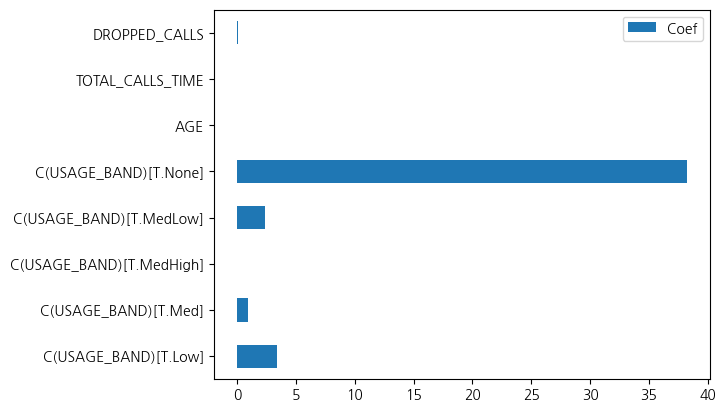

In [157]:
df_logistic_coef = pd.DataFrame({"Coef": log_result.params.values[1:]}, index = log_model.exog_names[1:])
df_logistic_coef.plot.barh(y = "Coef")

USAGE_BAND의 변수 영향도가 가장 크다

In [158]:
print(log_result.params.values[0:1])
print(log_model.exog_names[0:1])

[-3.31470943]
['Intercept']


In [159]:
df_char = df_raw.select_dtypes(include = "object")
df_numeric = df_raw.select_dtypes(exclude = "object")

# Data Scaling
scaler = StandardScaler()
np_numeric_scaled = scaler.fit_transform(df_numeric)
df_numeric_scaled = pd.DataFrame(np_numeric_scaled, columns = df_numeric.columns)

# 문자 데이터 + 숫자 데이터
df_scaled = pd.concat([df_numeric_scaled, df_char],axis = 1)
df_scaled.head()

,CHURN,GENDER,AGE,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME,CUSTOMER_ID,CHARGE_TYPE,HANDSET,USAGE_BAND
0,-0.489898,0.943527,-0.030604,-0.069958,0.949112,-0.032834,-0.617357,-0.432263,-0.755024,0.079015,-0.783880,K102990,CAT 100,ASAD170,Med
1,-0.489898,-1.059853,-0.335827,-0.243451,2.091732,0.651830,-0.080674,-0.307456,-0.579614,0.259163,-0.458260,K103280,CAT 100,S50,Med
2,-0.489898,-1.059853,-0.335827,1.063386,2.377387,0.152687,-0.225031,-0.993897,-1.347031,-0.325316,-0.817357,K103660,CAT 100,ASAD170,Med
3,-0.489898,-1.059853,2.258568,1.006966,-0.479163,0.302872,-0.070196,-0.120245,1.434855,-0.081116,-0.396795,K103730,CAT 100,ASAD170,Med
4,-0.489898,0.943527,1.571816,1.530970,-0.764818,-0.019583,-0.276254,-0.557071,-0.661838,-0.289287,-0.709610,K104560,CAT 100,S50,Med


In [160]:
df_scaled["CHURN"] = np.where(df_scaled["CHURN"]> 0, 1, 0)
df_scaled.head()

,CHURN,GENDER,AGE,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME,CUSTOMER_ID,CHARGE_TYPE,HANDSET,USAGE_BAND
0,0,0.943527,-0.030604,-0.069958,0.949112,-0.032834,-0.617357,-0.432263,-0.755024,0.079015,-0.783880,K102990,CAT 100,ASAD170,Med
1,0,-1.059853,-0.335827,-0.243451,2.091732,0.651830,-0.080674,-0.307456,-0.579614,0.259163,-0.458260,K103280,CAT 100,S50,Med
2,0,-1.059853,-0.335827,1.063386,2.377387,0.152687,-0.225031,-0.993897,-1.347031,-0.325316,-0.817357,K103660,CAT 100,ASAD170,Med
3,0,-1.059853,2.258568,1.006966,-0.479163,0.302872,-0.070196,-0.120245,1.434855,-0.081116,-0.396795,K103730,CAT 100,ASAD170,Med
4,0,0.943527,1.571816,1.530970,-0.764818,-0.019583,-0.276254,-0.557071,-0.661838,-0.289287,-0.709610,K104560,CAT 100,S50,Med


In [161]:
df_scaled_train, df_scaled_test = train_test_split(df_scaled, # 데이터
                               test_size = 0.3, # test 데이터의 비율
                               random_state = 1234)  # random state

In [162]:
scaled_log_model = Logit.from_formula("""CHURN ~ AGE + C(USAGE_BAND) + TOTAL_CALLS_TIME\
                                + DROPPED_CALLS""", df_train)
# 적합
scaled_log_result = scaled_log_model.fit()

# 결과 출력
print(log_result.summary())

         Current function value: 0.465636
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:                  CHURN   No. Observations:                  651
Model:                          Logit   Df Residuals:                      642
Method:                           MLE   Df Model:                            8
Date:                Thu, 07 Mar 2024   Pseudo R-squ.:                 0.08780
Time:                        16:33:52   Log-Likelihood:                -303.13
converged:                      False   LL-Null:                       -332.31
Covariance Type:            nonrobust   LLR p-value:                 9.787e-10
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
Intercept                   -3.3147      1.273     -2.604      0.009      -5.810      -0.820
C(USAGE_BAND)[T.Low]   

/home/piai/anaconda3/lib/python3.10/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


<Axes: >

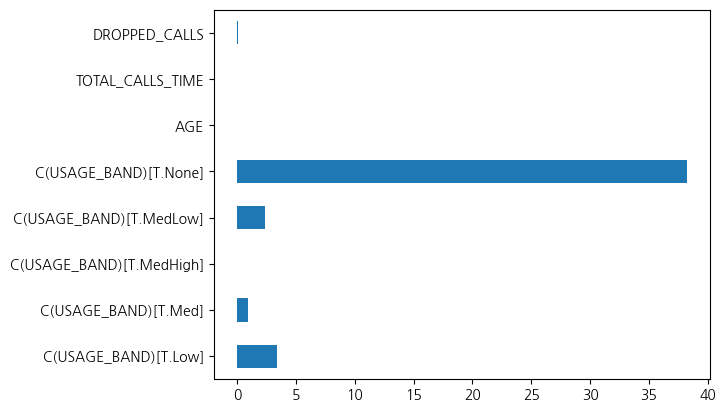

In [163]:
df_log_scaled_coef = pd.DataFrame({"Coef": scaled_log_result.params.values[1:]}, index = scaled_log_model.exog_names[1:])
df_log_scaled_coef.plot.barh(y = "Coef", legend = False)

결론적으로 USAGE_BAND의 변수 영향도가 가장 크며 이외의 다른 요소들은 크게 작용하지 않았다고 판단된다. <br>
하지만 이러한 영향은 다른 변수들의 환경 변화가 이뤄진다면 영향도의 변화가 있을 것으로 판단된다.

## 의사결정나무

In [179]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import matplotlib
 
from sklearn.tree import export_graphviz

import graphviz

from subprocess import call
from IPython.display import Image

from sklearn.model_selection import train_test_split

from sklearn.tree import DecisionTreeClassifier

from sklearn.model_selection import GridSearchCV

from sklearn.metrics import accuracy_score, f1_score 
from sklearn.metrics import confusion_matrix, classification_report

In [180]:
df_raw = pd.read_csv("../실습파일/2. Big Data 분석/통신고객이탈.csv")
df_raw.drop('CUSTOMER_ID', axis=1, inplace=True)
df_raw.head()

,CHURN,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,Active,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,Active,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,Active,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,Active,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,Active,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


In [181]:
df_raw["CHURN"] = df_raw["CHURN"].replace({"Active": 0, "Churned": 1})
df_raw['GENDER'] = df_raw['GENDER'].replace({'M': 0, 'F': 1})

In [182]:
df_raw_dummy = pd.get_dummies(df_raw)

In [183]:
df_raw_x = df_raw_dummy.drop("CHURN", axis = 1, inplace = False)
df_raw_y = df_raw_dummy["CHURN"] 

# 데이터 분할 train_test_split(X: 설명변수, Y: 목표변수, test_size = test 데이터 비율)
df_train_x, df_test_x, df_train_y, df_test_y = train_test_split(
    df_raw_x, df_raw_y, test_size = 0.3, random_state = 1234) 

print("분할 전 설명변수 데이터 :", df_raw_x.shape)
print("분할 후 설명변수 데이터 :Train", df_train_x.shape, "  Test",df_test_x.shape)

분할 전 설명변수 데이터 : (930, 32)
분할 후 설명변수 데이터 :Train (651, 32)   Test (279, 32)


In [184]:
display(df_raw.head(10))
display(df_raw_x.head(10))

,CHURN,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,0,1,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,0,0,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,0,0,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,0,0,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,0,1,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0
5,0,0,51,CAT 100,S80,Med,49.43,3,289,486.6,1,31.8,427,903.3
6,0,1,30,CAT 100,ASAD170,Med,32.30,6,427,729.6,12,52.8,490,907.2
7,0,0,36,CAT 100,ASAD170,Med,54.87,2,522,801.6,0,0.0,558,884.7
8,0,1,43,CAT 100,S50,Med,11.23,0,156,516.6,8,84.0,362,987.6
9,0,1,50,CAT 100,ASAD170,Med,49.97,0,136,466.2,13,31.8,186,632.7


,GENDER,AGE,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME,...,HANDSET_S80,HANDSET_SOP10,HANDSET_SOP20,HANDSET_WC95,USAGE_BAND_High,USAGE_BAND_Low,USAGE_BAND_Med,USAGE_BAND_MedHigh,USAGE_BAND_MedLow,USAGE_BAND_None
0,1,31,33.33,6,218,379.8,9,21.6,366,632.4,...,0,0,0,0,0,0,1,0,0,0
1,0,27,30.87,10,373,656.4,11,28.0,411,810.4,...,0,0,0,0,0,0,1,0,0,0
2,0,27,49.40,11,260,582.0,0,0.0,265,614.1,...,0,0,0,0,0,0,1,0,0,0
3,0,61,48.60,1,294,661.8,14,101.5,326,844.0,...,0,0,0,0,0,0,1,0,0,0
4,1,52,56.03,0,221,555.6,7,25.0,274,673.0,...,0,0,0,0,0,0,1,0,0,0
5,0,51,49.43,3,289,486.6,1,31.8,427,903.3,...,1,0,0,0,0,0,1,0,0,0
6,1,30,32.30,6,427,729.6,12,52.8,490,907.2,...,0,0,0,0,0,0,1,0,0,0
7,0,36,54.87,2,522,801.6,0,0.0,558,884.7,...,0,0,0,0,0,0,1,0,0,0
8,1,43,11.23,0,156,516.6,8,84.0,362,987.6,...,0,0,0,0,0,0,1,0,0,0
9,1,50,49.97,0,136,466.2,13,31.8,186,632.7,...,0,0,0,0,0,0,1,0,0,0


In [185]:
print("Data 구조:", df_raw_x.columns)
print()
print("변수 : ", df_train_x.columns)

Data 구조: Index(['GENDER', 'AGE', 'SERVICE_DURATION', 'DROPPED_CALLS', 'PEAK_CALLS_NO',
       'PEAK_CALLS_TIME', 'WEEKEND_CALLS_NO', 'WEEKEND_CALLS_TIME',
       'TOTAL_CALLS_NO', 'TOTAL_CALLS_TIME', 'CHARGE_TYPE_CAT 100',
       'CHARGE_TYPE_CAT 200', 'CHARGE_TYPE_CAT 50', 'CHARGE_TYPE_Play 100',
       'CHARGE_TYPE_Play 300', 'HANDSET_ASAD170', 'HANDSET_ASAD90',
       'HANDSET_BS110', 'HANDSET_BS210', 'HANDSET_CAS30', 'HANDSET_CAS60',
       'HANDSET_S50', 'HANDSET_S80', 'HANDSET_SOP10', 'HANDSET_SOP20',
       'HANDSET_WC95', 'USAGE_BAND_High', 'USAGE_BAND_Low', 'USAGE_BAND_Med',
       'USAGE_BAND_MedHigh', 'USAGE_BAND_MedLow', 'USAGE_BAND_None'],
      dtype='object')

변수 :  Index(['GENDER', 'AGE', 'SERVICE_DURATION', 'DROPPED_CALLS', 'PEAK_CALLS_NO',
       'PEAK_CALLS_TIME', 'WEEKEND_CALLS_NO', 'WEEKEND_CALLS_TIME',
       'TOTAL_CALLS_NO', 'TOTAL_CALLS_TIME', 'CHARGE_TYPE_CAT 100',
       'CHARGE_TYPE_CAT 200', 'CHARGE_TYPE_CAT 50', 'CHARGE_TYPE_Play 100',
       'CHARGE_TYPE_

In [186]:
from imblearn.over_sampling import SMOTE

CHURN
0        750
1        180
dtype: int64 

CHURN=1 비율   CHURN
False    0.806452
True     0.193548
dtype: float64


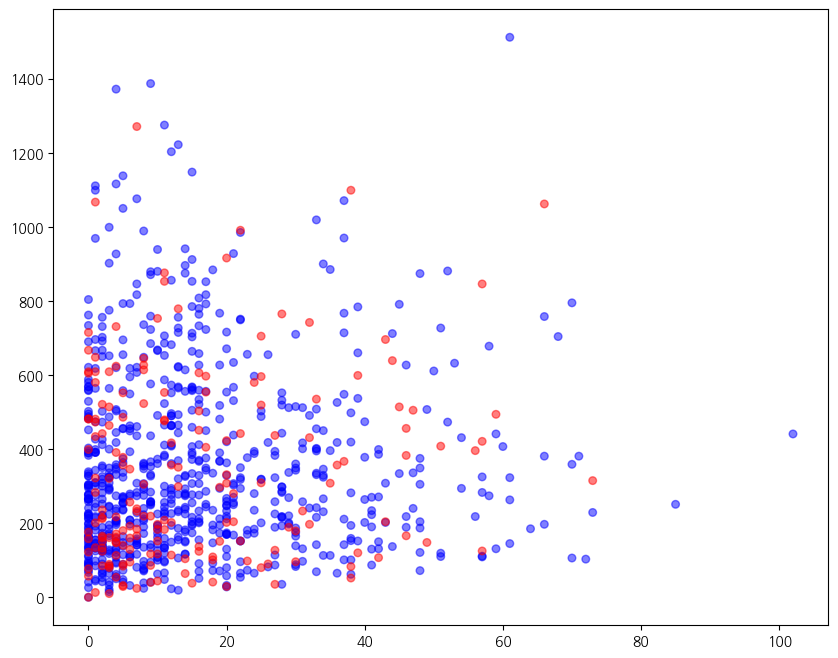

In [190]:
print(df_raw.value_counts(["CHURN"]),"\n")
print("CHURN=1 비율  ", df_raw.value_counts(df_raw["CHURN"]==1)/len(df_raw))
plt.figure(figsize=(10,8))
# 색깔 지정
df_raw['color'] = np.where(df_raw["CHURN"]==1, "red", "blue")
plt.scatter(df_raw['WEEKEND_CALLS_NO'],df_raw['TOTAL_CALLS_NO'],c=df_raw['color'], s=30, alpha=0.5)

In [191]:
sm = SMOTE(sampling_strategy='auto', random_state=1234)

# train데이터를 이용한 Over-sampling
x_resampled, y_resampled = sm.fit_resample(df_train_x,df_train_y)

# 결과 확인
print('Over-Sampling 전:\n',df_train_y.value_counts(),"\n")
print('Over-Sampling 후 Train X: {}'.format(x_resampled.shape))
print('Over-Sampling 후 Train Y: {} \n'.format(y_resampled.shape))

print("Over-Sampling 후 '1':{}".format(sum(y_resampled==1)))
print("Over-Sampling 후 '0':{}".format(sum(y_resampled==0)))

Over-Sampling 전:
 0    515
1    136
Name: CHURN, dtype: int64 

Over-Sampling 후 Train X: (1030, 32)
Over-Sampling 후 Train Y: (1030,) 

Over-Sampling 후 '1':515
Over-Sampling 후 '0':515


   GENDER  AGE  SERVICE_DURATION  DROPPED_CALLS  PEAK_CALLS_NO  \
0       1   40             36.00              2            556   
1       1   41             45.33             11             73   
2       1   26             55.07              0            546   
3       1   24             50.83              2            249   
4       0   32             55.63             10            125   

   PEAK_CALLS_TIME  WEEKEND_CALLS_NO  WEEKEND_CALLS_TIME  TOTAL_CALLS_NO  \
0           1436.4                 8                74.0             736   
1            403.2                15                39.0             204   
2           1228.2                 0                 0.0             588   
3            445.2                 6                15.0             274   
4            232.2                 4               112.8             159   

   TOTAL_CALLS_TIME  ...  HANDSET_SOP10  HANDSET_SOP20  HANDSET_WC95  \
0            1862.9  ...              0              0             0   
1 

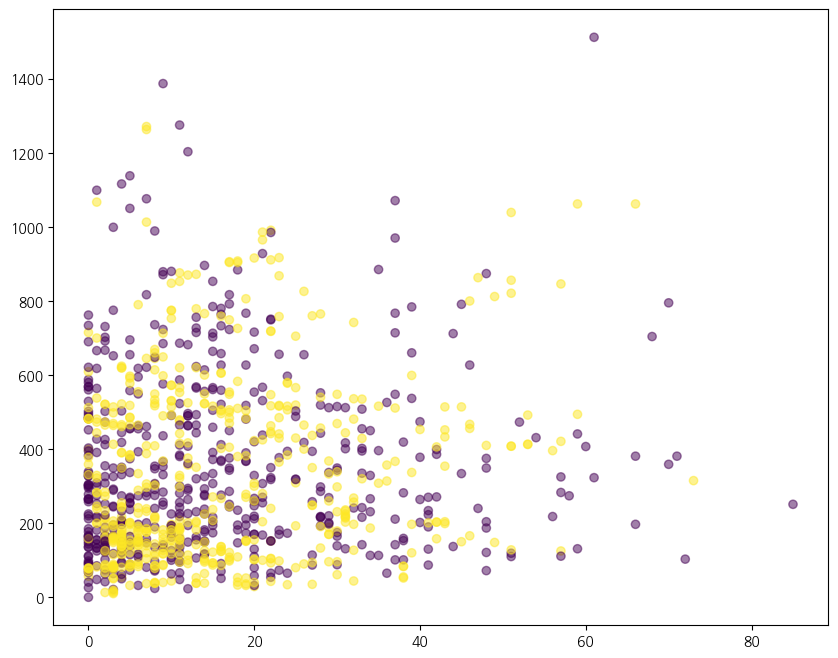

In [192]:
df_resampled = pd.concat([x_resampled,y_resampled], axis=1)
print(df_resampled.head())

# 목표변수 산점도 확인:위와 다른 방식으로 색깔 구분
plt.figure(figsize=(10,8))
plt.scatter(df_resampled['WEEKEND_CALLS_NO'],df_resampled['TOTAL_CALLS_NO'],
            c=df_resampled['CHURN'],alpha=0.5)
plt.show()

In [193]:
tree_uncust = DecisionTreeClassifier(random_state=1234 )
tree_uncust.fit(df_train_x, df_train_y)

# train 데이터 정확도
print("Accuracy on training set: {:.3f}".format(tree_uncust.score(df_train_x, df_train_y)))
# test 데이터 정확도
print("Accuracy on test set: {:.3f}".format(tree_uncust.score(df_test_x, df_test_y)))

Accuracy on training set: 1.000
Accuracy on test set: 0.828


train dataset에 대한 모델 정확도는 100%이고 test dataset에 82.8%로 모델은 train으로 과적합되었음

In [194]:
print(tree_uncust.get_params().keys())
print(tree_uncust.get_params().values())

dict_keys(['ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'min_impurity_decrease', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'random_state', 'splitter'])
dict_values([0.0, None, 'gini', None, None, None, 0.0, 1, 2, 0.0, 1234, 'best'])


In [195]:
# train 및 test 정확도 결과 저장용
train_accuracy = []; test_accuracy = []
# max_depth: 최대 깊이 변경.
para_depth = [depth for depth in range(3, 12)]

for v_max_depth in para_depth:
    tree = DecisionTreeClassifier(max_depth = v_max_depth, random_state=1234)
    tree.fit(df_train_x, df_train_y)
    train_accuracy.append(tree.score(df_train_x, df_train_y))
    test_accuracy.append(tree.score(df_test_x, df_test_y))

# 데이터 테이블로 저장
df_accuracy_depth = pd.DataFrame()
df_accuracy_depth["Depth"] = para_depth
df_accuracy_depth["TrainAccuracy"] = train_accuracy
df_accuracy_depth["TestAccuracy"] = test_accuracy

In [196]:
para_depth

[3, 4, 5, 6, 7, 8, 9, 10, 11]

In [197]:
df_accuracy_depth.round(3)

,Depth,TrainAccuracy,TestAccuracy
0,3,0.889,0.910
1,4,0.892,0.910
2,5,0.920,0.903
3,6,0.931,0.875
4,7,0.951,0.846
5,8,0.959,0.867
6,9,0.966,0.842
7,10,0.974,0.849
8,11,0.980,0.832


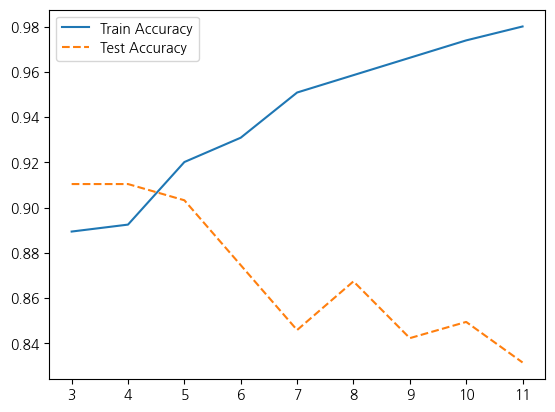

In [198]:
plt.plot(para_depth, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_depth, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.legend()

최대 깊이 증가에 따라 모델의 train 정확도는 증가하나 test 정확도는 감소한다.<br>
이는 overfitting 문제로 인해 발생한 것으로 여겨진다.

In [199]:
v_feature_name = df_train_x.columns

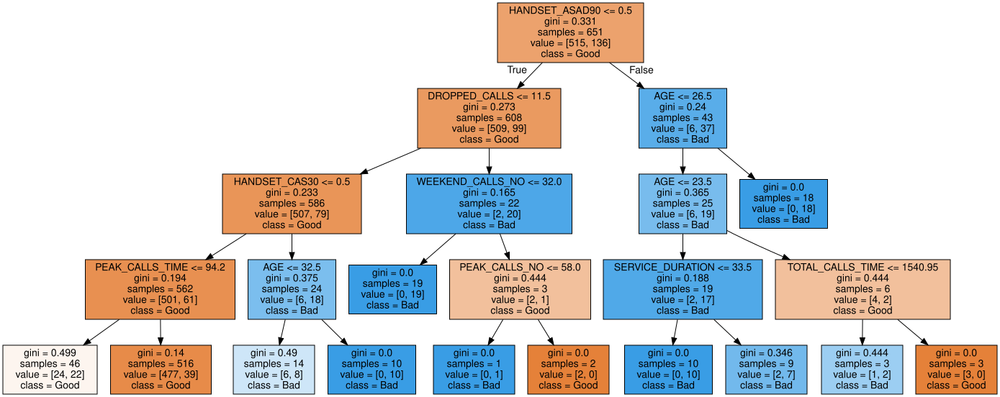

In [200]:
tree_low = DecisionTreeClassifier(max_depth = 4, random_state=1234)
tree_low.fit(df_train_x, df_train_y)

# 트리 모델을 tree_low.dot 파일로 저장. (목표변수 레이블 지정(class_names):0-Good,1-Bad)
export_graphviz(tree_low, out_file="tree_low.dot", class_names = ["Good", "Bad"], 
                feature_names = v_feature_name, impurity = True, filled = True)

# 트리 결과 시각화
with open("tree_low.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [201]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_low.dot', '-o', 'tree_low.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_low.png')

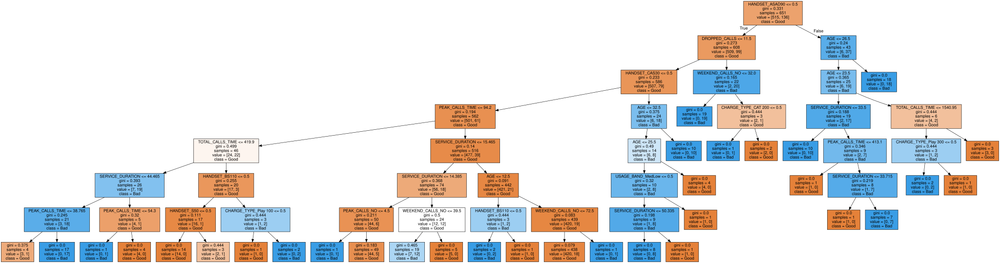

In [202]:
tree_high = DecisionTreeClassifier(max_depth = 7, random_state=1234)
tree_high.fit(df_train_x, df_train_y)

export_graphviz(tree_high, out_file="tree_high.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)
#                 feature_names = v_feature_name, impurity = True, filled = True, max_depth=5) # 표시 max_depth 지정 가능

with open("tree_high.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [203]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_high.dot', '-o', 'tree_high.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_high.png')

In [204]:
# 참조:적정 자료 수 검토:Train Data 자료 수
print("전체 자료 = ", df_train_x.shape[0],"개")
print("전체 자료의 1% = ", df_train_x.shape[0] * 0.01,"개")

# train 및 test 정확도 결과 저장용
train_accuracy = []; test_accuracy = []
# min_samples_split: 분할하기 위한 노드의 최소 샘플 수 
para_split = [n_split * 10 for n_split in range(2, 16)]

for v_min_samples_split in para_split:
    tree = DecisionTreeClassifier(min_samples_split = v_min_samples_split, max_depth=7, random_state=1234)
    tree.fit(df_train_x, df_train_y)
    train_accuracy.append(tree.score(df_train_x, df_train_y))
    test_accuracy.append(tree.score(df_test_x, df_test_y))

# 데이터 테이블로 저장
df_accuracy_split = pd.DataFrame()
df_accuracy_split["MinSamplesSplit"] = para_split
df_accuracy_split["TrainAccuracy"] = train_accuracy
df_accuracy_split["TestAccuracy"] = test_accuracy

전체 자료 =  651 개
전체 자료의 1% =  6.51 개


In [205]:
# 모델 정확도 확인
df_accuracy_split.round(3)

,MinSamplesSplit,TrainAccuracy,TestAccuracy
0,20,0.929,0.853
1,30,0.908,0.889
2,40,0.908,0.889
3,50,0.889,0.892
4,60,0.888,0.892
5,70,0.888,0.892
6,80,0.888,0.892
7,90,0.888,0.892
8,100,0.888,0.892
9,110,0.888,0.892


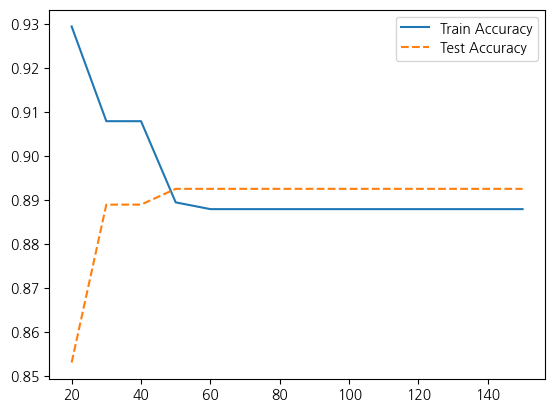

In [206]:
# 정확도를 그래프로 표현
plt.plot(para_split, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_split, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.legend()

파라미터 조정에 따라 train accuracy가 감소하다가 일정하게 유지되며 test accuracy가 소폭 상승한 걸 확인할 수 있다.

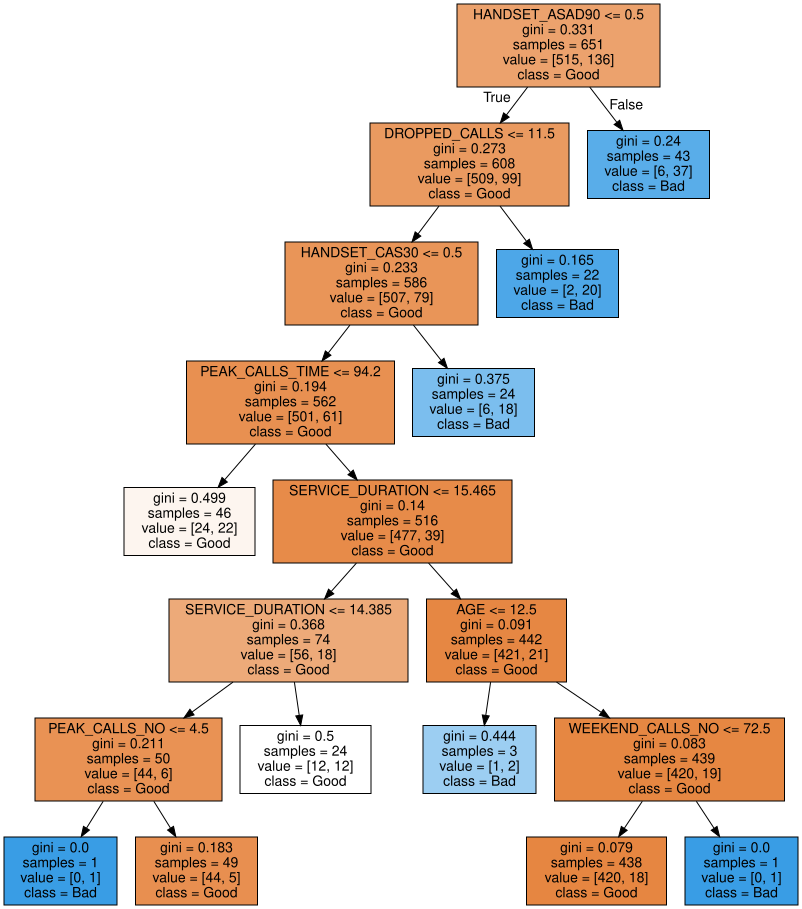

In [207]:
# 분리 노드의 최소 자료 수:적은 모델
tree_low = DecisionTreeClassifier(max_depth=7, min_samples_split=50, random_state=1234)
tree_low.fit(df_train_x, df_train_y)

export_graphviz(tree_low, out_file="tree_low.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_low.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [208]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_low.dot', '-o', 'tree_low.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_low.png')

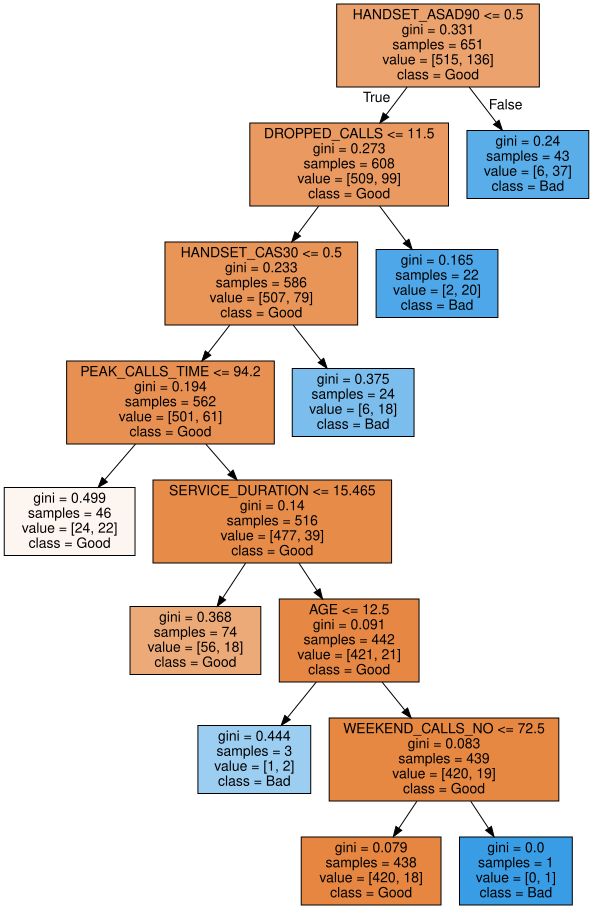

In [209]:
# 분리 노드의 최소 자료 수: 많은 모델
tree_high = DecisionTreeClassifier(max_depth=7, min_samples_split=110, random_state=1234)
tree_high.fit(df_train_x, df_train_y)

export_graphviz(tree_high, out_file="tree_high.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_high.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

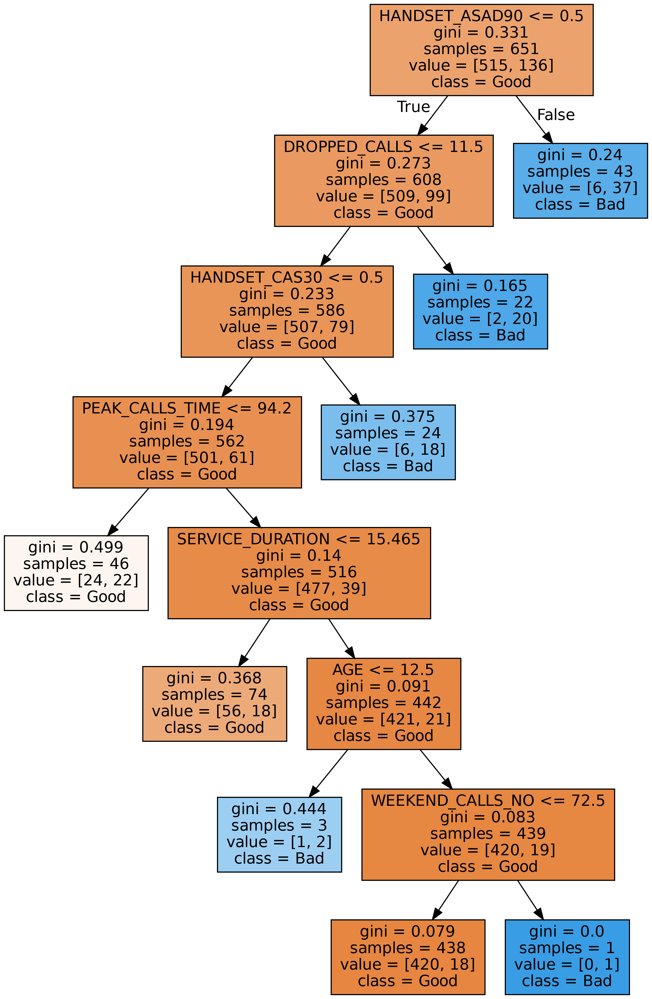

In [210]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_high.dot', '-o', 'tree_high.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_high.png')

In [212]:
# train 및 test 정확도 결과 저장용
train_accuracy = []; test_accuracy = []
# min_samples_leaf: 잎사귀 노드 최소 자료 수. 
para_leaf = [n_leaf * 2 for n_leaf in range(5,16)]

for v_min_samples_leaf in para_leaf:
    tree = DecisionTreeClassifier(min_samples_leaf = v_min_samples_leaf, min_samples_split=50, \
		max_depth=7, random_state=1234)
    tree.fit(df_train_x, df_train_y)
    train_accuracy.append(tree.score(df_train_x, df_train_y))
    test_accuracy.append(tree.score(df_test_x, df_test_y))

# 데이터 테이블로 저장
df_accuracy_leaf = pd.DataFrame()
df_accuracy_leaf["MinSamplesLeaf"] = para_leaf
df_accuracy_leaf["TrainAccuracy"] = train_accuracy
df_accuracy_leaf["TestAccuracy"] = test_accuracy

[10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30]
    MinSamplesLeaf  TrainAccuracy  TestAccuracy
0               10          0.885         0.914
1               12          0.885         0.914
2               14          0.885         0.914
3               16          0.885         0.914
4               18          0.885         0.914
5               20          0.885         0.914
6               22          0.885         0.914
7               24          0.863         0.896
8               26          0.848         0.871
9               28          0.848         0.871
10              30          0.848         0.871


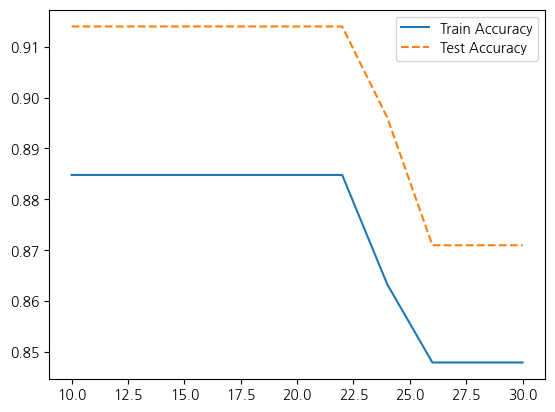

In [213]:
print(para_leaf)
print(df_accuracy_leaf.round(3))
plt.plot(para_leaf, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_leaf, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.legend()

분리 노드의 최소 자료 수 증가에 따라 모델의 정확도는 감소했다. <br>
22를 기준으로 성능이 약간 저하되는 걸 확인할 수 있다.

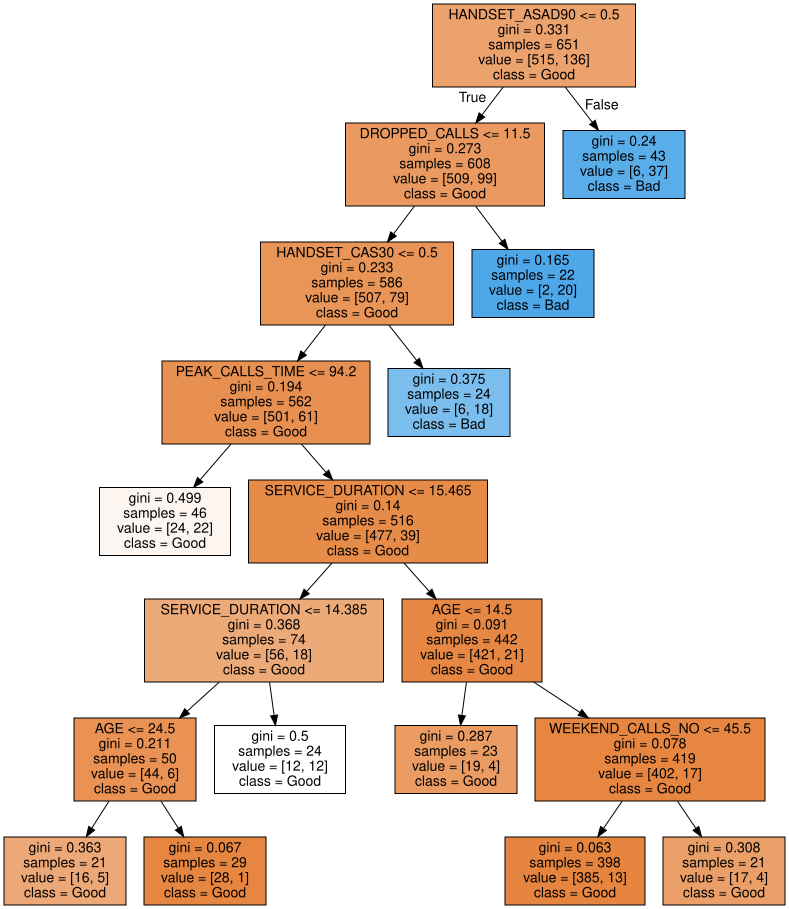

In [214]:
tree_low = DecisionTreeClassifier(max_depth=7, min_samples_split=50, min_samples_leaf=14, random_state=1234)
tree_low.fit(df_train_x, df_train_y)

export_graphviz(tree_low, out_file=" tree_low.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open(" tree_low.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [215]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_low.dot', '-o', 'tree_low.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_low.png')

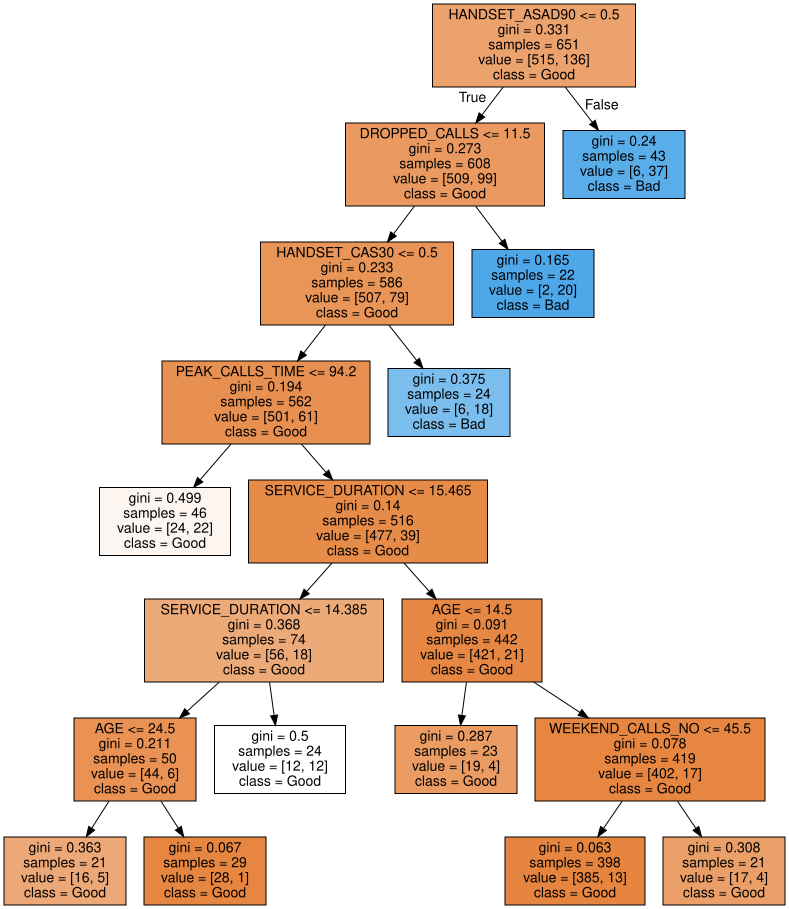

In [216]:
tree_high = DecisionTreeClassifier(max_depth=7, min_samples_split=50, min_samples_leaf=18, random_state=1234)
tree_high.fit(df_train_x, df_train_y)

export_graphviz(tree_high, out_file="tree_high.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_high.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [217]:
tree_final = DecisionTreeClassifier(max_depth=7, min_samples_split=50, min_samples_leaf=14, random_state=1234)
tree_final.fit(df_train_x, df_train_y)

DecisionTreeClassifier(max_depth=7, min_samples_leaf=14, min_samples_split=50,
                       random_state=1234)

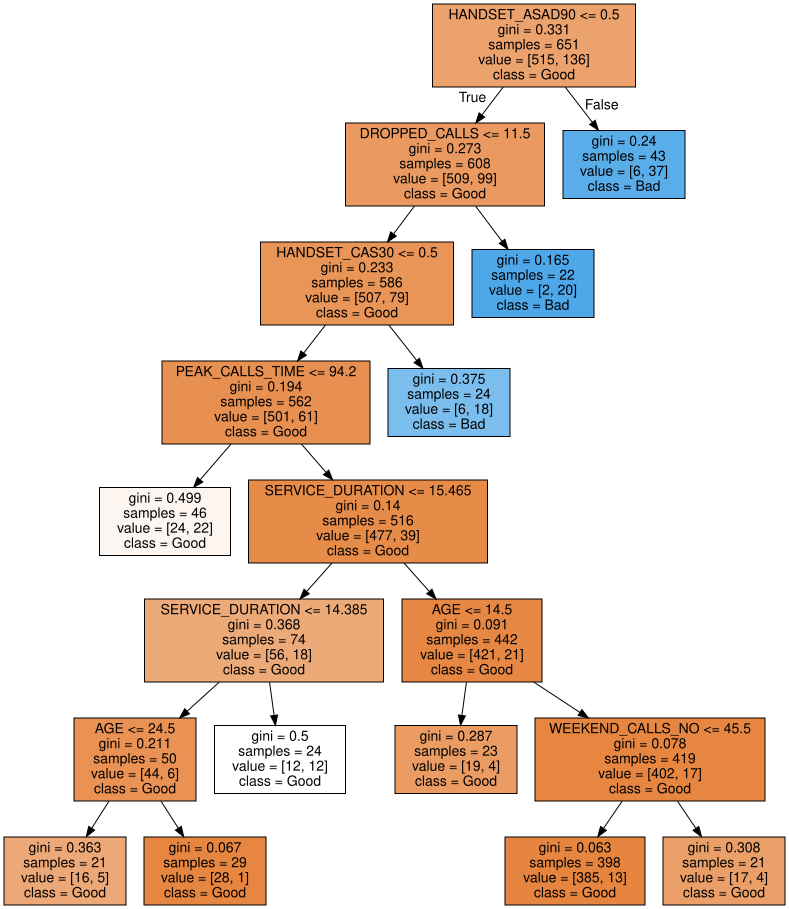

In [218]:
export_graphviz(tree_final, out_file="tree_final.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_final.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

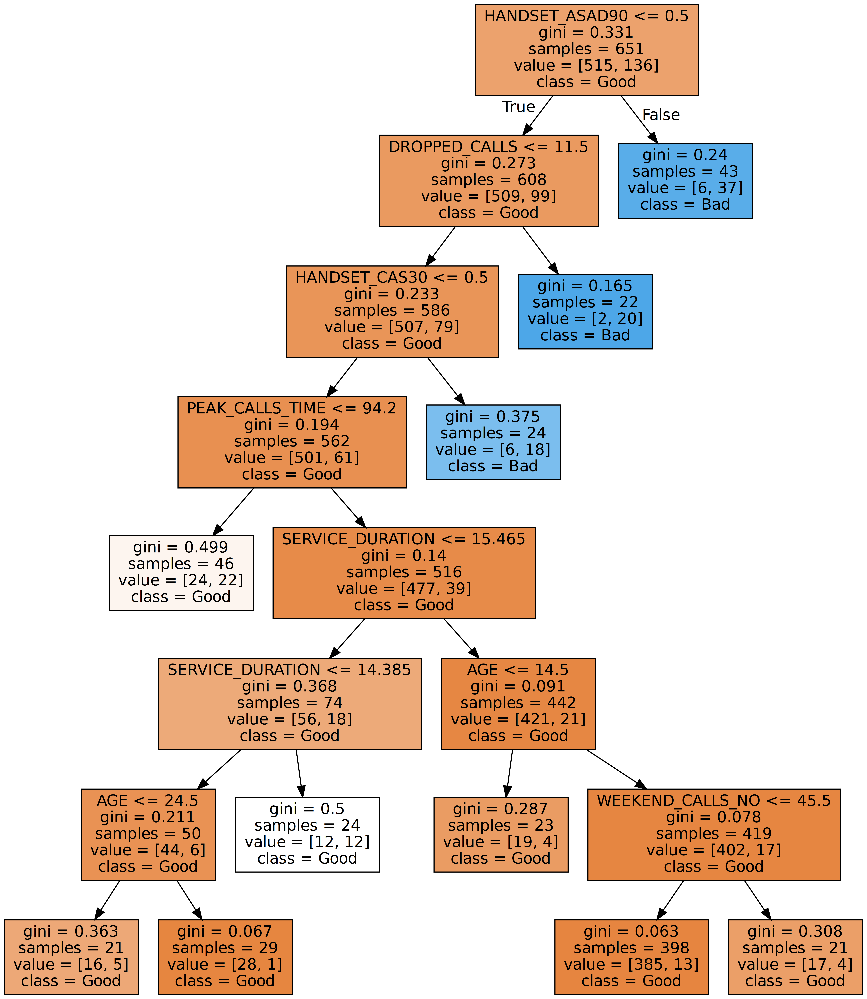

In [219]:
call(['dot', '-Tpng', 'tree_final.dot', '-o', 'tree_final.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_final.png')

In [220]:
y_pred = tree_final.predict(df_test_x)
print("Test Accuracy: {0:.3f}\n".format(tree_final.score(df_test_x, df_test_y)))
print("Test Confusion matrix: \n{}".format(confusion_matrix(df_test_y, y_pred)))

# 목표변수의 빈도 불균형 : f1 score로 모델 평가 
print(classification_report(df_test_y, y_pred, digits=3))

Test Accuracy: 0.914

Test Confusion matrix: 
[[228   7]
 [ 17  27]]
              precision    recall  f1-score   support

           0      0.931     0.970     0.950       235
           1      0.794     0.614     0.692        44

    accuracy                          0.914       279
   macro avg      0.862     0.792     0.821       279
weighted avg      0.909     0.914     0.909       279



precision과 recall, f1-score 등의 성과지표가 이전의 로지스틱 회귀보다 준수하게 나오는 걸 확인할 수 있다.<br>
더불어 accuracy 또한 91.4%로 높게 나온 걸 확인할 수 있다.

In [221]:
df_importance = pd.DataFrame()
df_importance["Feature"] = v_feature_name
df_importance["Importance"] = tree_final.feature_importances_

# df_feature_importance의 테이블을 중요도별로 정렬
df_importance.sort_values("Importance", ascending=False, inplace = True)
df_importance.round(3)

,Feature,Importance
16,HANDSET_ASAD90,0.357
3,DROPPED_CALLS,0.232
19,HANDSET_CAS30,0.173
5,PEAK_CALLS_TIME,0.125
2,SERVICE_DURATION,0.087
1,AGE,0.016
6,WEEKEND_CALLS_NO,0.009
24,HANDSET_SOP20,0.000
21,HANDSET_S50,0.000
22,HANDSET_S80,0.000


Text(0, 0.5, '설명변수')

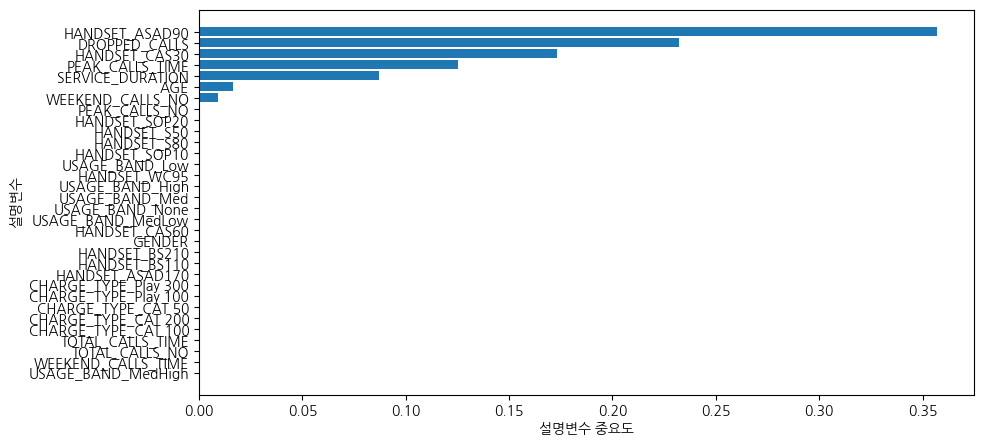

In [222]:
df_importance.sort_values("Importance", ascending=True, inplace = True)
coordinates = range(len(df_importance))

plt.figure(figsize=(10,5))
plt.barh(y = coordinates, width = df_importance["Importance"])
plt.yticks(coordinates, df_importance["Feature"])
plt.xlabel("설명변수 중요도")
plt.ylabel("설명변수")

더미 변수로 변환한 HANDSET_ASAD90, DROPPED_CALLS, HANDSET_CAS30가 차례로 중요한 설명변수임을 확인할 수 있음 <br>
단, 계산된 변수 중요도 값이 낮거나 0이더라도 Train 데이터의 중요도에 따라 순서가 변경될 수 있음 <br>

In [224]:
tree_final2 = DecisionTreeClassifier(criterion='entropy', max_depth=7, min_samples_split=50, min_samples_leaf=14, random_state=1234)
tree_final2.fit(df_train_x, df_train_y)

DecisionTreeClassifier(criterion='entropy', max_depth=7, min_samples_leaf=14,
                       min_samples_split=50, random_state=1234)

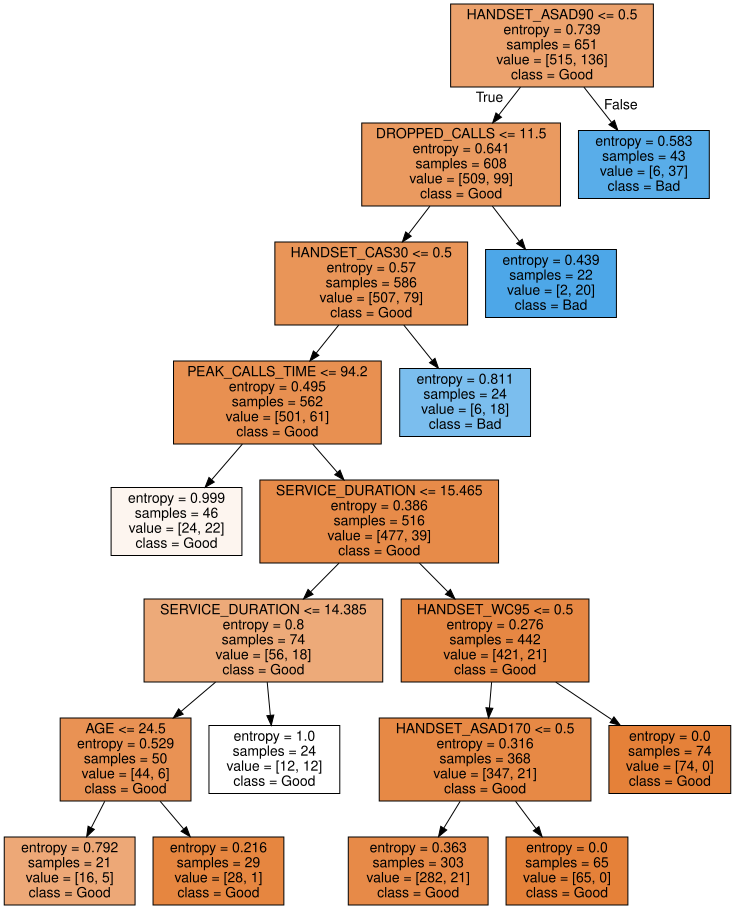

In [225]:
export_graphviz(tree_final2, out_file="tree_final2.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_final2.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

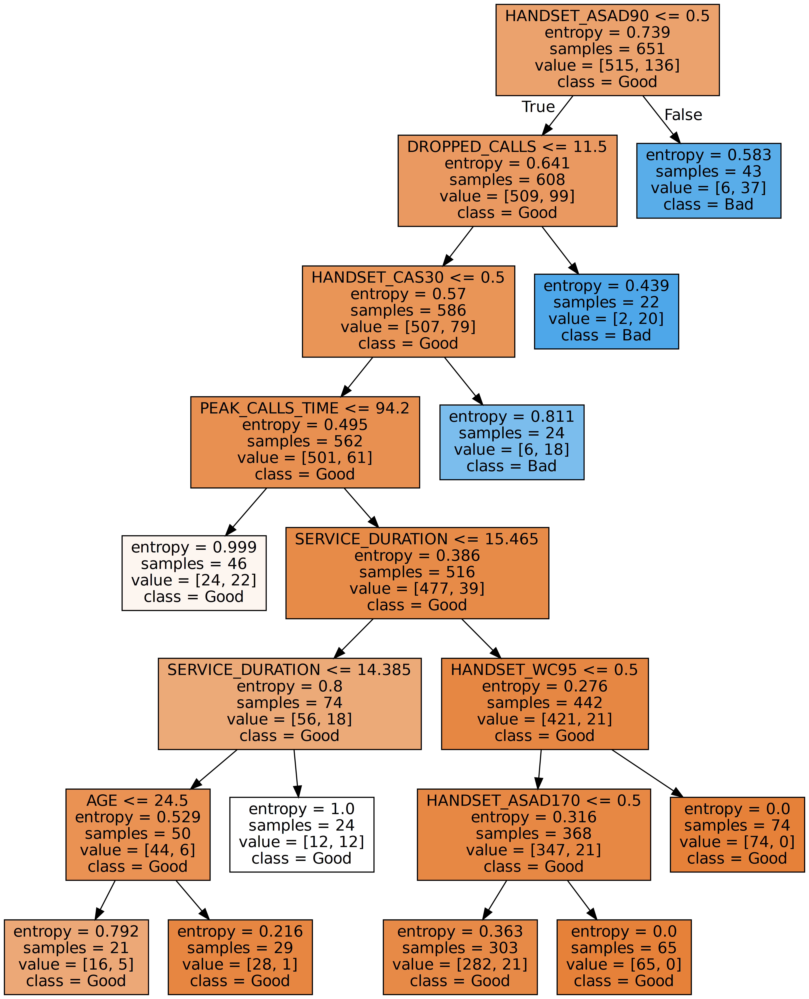

In [226]:
call(['dot', '-Tpng', 'tree_final2.dot', '-o', 'tree_final2.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_final2.png')

In [227]:
# 평가
y_pred = tree_final.predict(df_test_x)
print("Accuracy: {0:.3f}\n".format(tree_final.score(df_test_x, df_test_y)))
print("Confusion matrix: \n{}".format(confusion_matrix(df_test_y, y_pred)))

# 목표변수의 빈도 불균형 : f1 score로 모델 평가 
print(classification_report(df_test_y, y_pred, digits=3))

Accuracy: 0.914

Confusion matrix: 
[[228   7]
 [ 17  27]]
              precision    recall  f1-score   support

           0      0.931     0.970     0.950       235
           1      0.794     0.614     0.692        44

    accuracy                          0.914       279
   macro avg      0.862     0.792     0.821       279
weighted avg      0.909     0.914     0.909       279



In [228]:
# tree.feature_importances_로 설명변수 중요도 확인 및 테이블로 저장
df_importance = pd.DataFrame()
df_importance["Feature"] = v_feature_name
df_importance["Importance"] = tree_final.feature_importances_

# df_feature_importance의 테이블을 중요도별로 정렬
df_importance.sort_values("Importance", ascending=False, inplace = True)
df_importance.round(3)

,Feature,Importance
16,HANDSET_ASAD90,0.357
3,DROPPED_CALLS,0.232
19,HANDSET_CAS30,0.173
5,PEAK_CALLS_TIME,0.125
2,SERVICE_DURATION,0.087
1,AGE,0.016
6,WEEKEND_CALLS_NO,0.009
24,HANDSET_SOP20,0.000
21,HANDSET_S50,0.000
22,HANDSET_S80,0.000


In [229]:
# 데이터 분할 train_test_split(X: 설명변수, Y: 목표변수, test_size = test 데이터 비율)
df_train_x_over, df_test_x_over, df_train_y_over, df_test_y_over = train_test_split(
    x_resampled, y_resampled, test_size = 0.3, stratify=y_resampled, random_state = 1234) 

print("분할 전 데이터 현황... 설명:", x_resampled.shape, "  목표:", y_resampled.shape)
print("분할 후 설명변수 현황...Train:", df_train_x_over.shape, " Test:", df_test_x_over.shape)
print("분할 후 목표변수 현황...Train:", df_train_y_over.value_counts(), " Test:", df_test_y_over.value_counts())

분할 전 데이터 현황... 설명: (1030, 32)   목표: (1030,)
분할 후 설명변수 현황...Train: (721, 32)  Test: (309, 32)
분할 후 목표변수 현황...Train: 0    361
1    360
Name: CHURN, dtype: int64  Test: 1    155
0    154
Name: CHURN, dtype: int64


In [230]:
tree_final_over = DecisionTreeClassifier(max_depth=7, min_samples_split=50, min_samples_leaf=14, random_state=1234)

tree_final_over.fit(df_train_x_over, df_train_y_over)

DecisionTreeClassifier(max_depth=7, min_samples_leaf=14, min_samples_split=50,
                       random_state=1234)

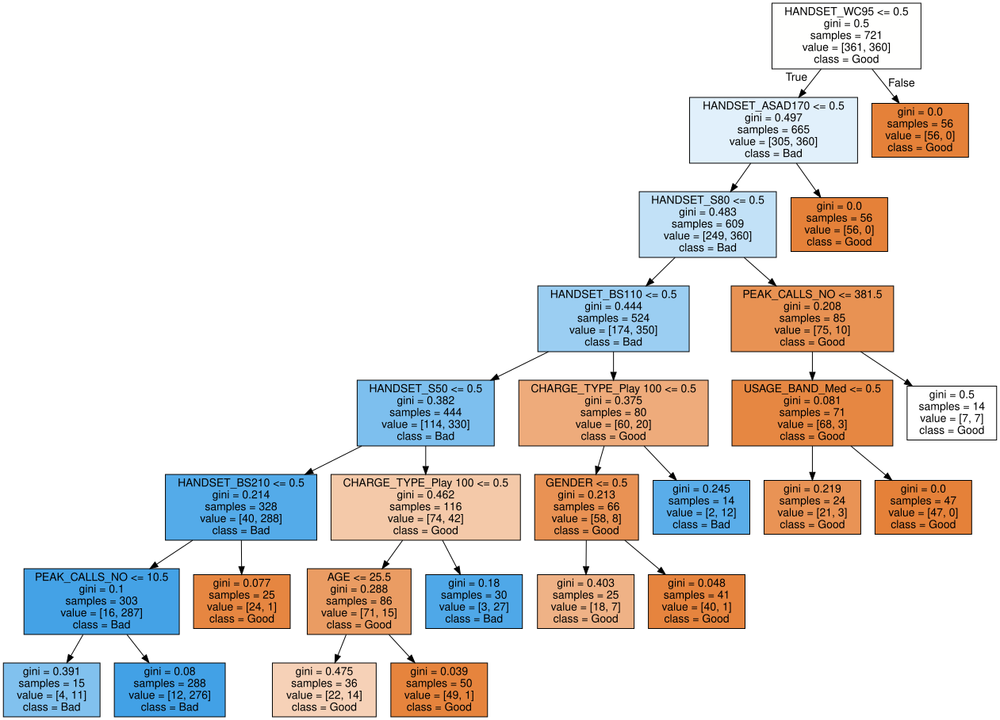

In [231]:
export_graphviz(tree_final_over, out_file="tree_final_over.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_final_over.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [232]:
call(['dot', '-Tpng', 'tree_final_over.dot', '-o', 'tree_final_over.png', '-Gdpi=600'])

Image(filename = 'tree_final_over.png')

최종적으로 도출된 트리 분리에 영향이 큰 순서는 HANDSET_WC95, HANDSET_ASAD170, HANDSET_S80 등이다. <br>
Over-Sampling으로 인해 결정트리 내용/구조가 달라진다.

In [233]:
y_pred_over = tree_final_over.predict(df_test_x_over)
print("Test Accuracy: {0:.3f}\n".format(tree_final_over.score(df_test_x_over, df_test_y_over)))
print("Test Confusion matrix: \n{}".format(confusion_matrix(df_test_y_over, y_pred_over)))

print(classification_report(df_test_y_over, y_pred_over, digits=3))

Test Accuracy: 0.903

Test Confusion matrix: 
[[144  10]
 [ 20 135]]
              precision    recall  f1-score   support

           0      0.878     0.935     0.906       154
           1      0.931     0.871     0.900       155

    accuracy                          0.903       309
   macro avg      0.905     0.903     0.903       309
weighted avg      0.905     0.903     0.903       309



정확도를 비롯하여 precision, recall, f1-score의 점수가 높게 나온 걸 확인할 수 있다. <br>
이를 통해 앞선 over sampling, 모델의 parameter 조정 등이 효과적으로 작용했음을 알 수 있다.

In [234]:
df_importance = pd.DataFrame()
df_importance["Feature"] = v_feature_name
df_importance["Importance"] = tree_final_over.feature_importances_

df_importance.sort_values("Importance", ascending=False, inplace = True)
df_importance.round(3)

,Feature,Importance
21,HANDSET_S50,0.164
22,HANDSET_S80,0.160
18,HANDSET_BS210,0.137
13,CHARGE_TYPE_Play 100,0.129
15,HANDSET_ASAD170,0.129
17,HANDSET_BS110,0.119
25,HANDSET_WC95,0.109
4,PEAK_CALLS_NO,0.023
1,AGE,0.021
0,GENDER,0.007


Text(0, 0.5, '설명변수')

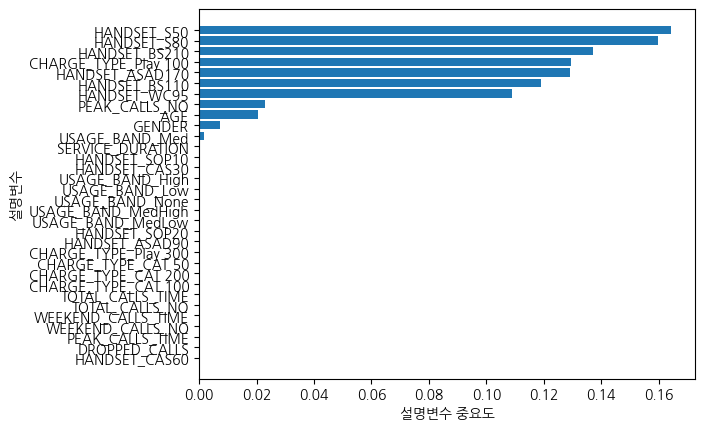

In [235]:
 
df_importance.sort_values("Importance", ascending=True, inplace = True)
coordinates = range(len(df_importance))
plt.barh(y = coordinates, width = df_importance["Importance"])
plt.yticks(coordinates, df_importance["Feature"])
plt.xlabel("설명변수 중요도")
plt.ylabel("설명변수")

이전 결과와는 상이하게 다양한 변수들에 대해 변수의 중요도가 다뤄졌으며 특히 HANDSET의 다양한 파트들이 표의 상단에 위치한 걸 확인할 수 있다.

## 랜덤 포레스트

In [240]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib

from sklearn.model_selection import train_test_split

from sklearn.ensemble import RandomForestClassifier

from sklearn.model_selection import GridSearchCV

from sklearn.metrics import accuracy_score, f1_score 
from sklearn.metrics import confusion_matrix, classification_report

In [241]:
df_raw = pd.read_csv("../실습파일/2. Big Data 분석/통신고객이탈.csv")
df_raw.head()

,CHURN,CUSTOMER_ID,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,Active,K102990,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,Active,K103280,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,Active,K103660,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,Active,K103730,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,Active,K104560,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


In [242]:
# Data 구조 확인
print("Data 구조:", df_raw.shape)
print()
print("변수 : ", df_raw.columns)

Data 구조: (930, 15)

변수 :  Index(['CHURN', 'CUSTOMER_ID', 'GENDER', 'AGE', 'CHARGE_TYPE', 'HANDSET',
       'USAGE_BAND', 'SERVICE_DURATION', 'DROPPED_CALLS', 'PEAK_CALLS_NO',
       'PEAK_CALLS_TIME', 'WEEKEND_CALLS_NO', 'WEEKEND_CALLS_TIME',
       'TOTAL_CALLS_NO', 'TOTAL_CALLS_TIME'],
      dtype='object')


In [243]:
# 결측치 확인
df_raw.isnull().sum(axis = 0)

CHURN                 0
CUSTOMER_ID           0
GENDER                0
AGE                   0
CHARGE_TYPE           0
HANDSET               0
USAGE_BAND            0
SERVICE_DURATION      0
DROPPED_CALLS         0
PEAK_CALLS_NO         0
PEAK_CALLS_TIME       0
WEEKEND_CALLS_NO      0
WEEKEND_CALLS_TIME    0
TOTAL_CALLS_NO        0
TOTAL_CALLS_TIME      0
dtype: int64

In [244]:
df_raw = pd.read_csv("../실습파일/2. Big Data 분석/통신고객이탈.csv")
df_raw.drop('CUSTOMER_ID', axis=1, inplace=True)
df_raw.head()

,CHURN,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,Active,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,Active,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,Active,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,Active,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,Active,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


In [245]:
df_raw["CHURN"] = df_raw["CHURN"].replace({"Active": 0, "Churned": 1})
df_raw['GENDER'] = df_raw['GENDER'].replace({'M': 0, 'F': 1})

In [246]:
df_raw_dummy = pd.get_dummies(df_raw)
df_raw_dummy.head()

,CHURN,GENDER,AGE,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,...,HANDSET_S80,HANDSET_SOP10,HANDSET_SOP20,HANDSET_WC95,USAGE_BAND_High,USAGE_BAND_Low,USAGE_BAND_Med,USAGE_BAND_MedHigh,USAGE_BAND_MedLow,USAGE_BAND_None
0,0,1,31,33.33,6,218,379.8,9,21.6,366,...,0,0,0,0,0,0,1,0,0,0
1,0,0,27,30.87,10,373,656.4,11,28.0,411,...,0,0,0,0,0,0,1,0,0,0
2,0,0,27,49.40,11,260,582.0,0,0.0,265,...,0,0,0,0,0,0,1,0,0,0
3,0,0,61,48.60,1,294,661.8,14,101.5,326,...,0,0,0,0,0,0,1,0,0,0
4,0,1,52,56.03,0,221,555.6,7,25.0,274,...,0,0,0,0,0,0,1,0,0,0


In [247]:
df_raw_x = df_raw_dummy.drop("CHURN", axis = 1, inplace = False)
df_raw_y = df_raw_dummy["CHURN"] 

df_train_x, df_test_x, df_train_y, df_test_y = train_test_split(
    df_raw_x, df_raw_y, test_size = 0.3, random_state = 1234) 

print("분할 전 설명변수 데이터 :", df_raw_x.shape)
print("분할 후 설명변수 데이터 :Train", df_train_x.shape, "  Test",df_test_x.shape)

분할 전 설명변수 데이터 : (930, 32)
분할 후 설명변수 데이터 :Train (651, 32)   Test (279, 32)


In [248]:
display(df_raw.head(10))
display(df_raw_x.head(10))

,CHURN,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,0,1,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,0,0,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,0,0,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,0,0,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,0,1,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0
5,0,0,51,CAT 100,S80,Med,49.43,3,289,486.6,1,31.8,427,903.3
6,0,1,30,CAT 100,ASAD170,Med,32.30,6,427,729.6,12,52.8,490,907.2
7,0,0,36,CAT 100,ASAD170,Med,54.87,2,522,801.6,0,0.0,558,884.7
8,0,1,43,CAT 100,S50,Med,11.23,0,156,516.6,8,84.0,362,987.6
9,0,1,50,CAT 100,ASAD170,Med,49.97,0,136,466.2,13,31.8,186,632.7


,GENDER,AGE,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME,...,HANDSET_S80,HANDSET_SOP10,HANDSET_SOP20,HANDSET_WC95,USAGE_BAND_High,USAGE_BAND_Low,USAGE_BAND_Med,USAGE_BAND_MedHigh,USAGE_BAND_MedLow,USAGE_BAND_None
0,1,31,33.33,6,218,379.8,9,21.6,366,632.4,...,0,0,0,0,0,0,1,0,0,0
1,0,27,30.87,10,373,656.4,11,28.0,411,810.4,...,0,0,0,0,0,0,1,0,0,0
2,0,27,49.40,11,260,582.0,0,0.0,265,614.1,...,0,0,0,0,0,0,1,0,0,0
3,0,61,48.60,1,294,661.8,14,101.5,326,844.0,...,0,0,0,0,0,0,1,0,0,0
4,1,52,56.03,0,221,555.6,7,25.0,274,673.0,...,0,0,0,0,0,0,1,0,0,0
5,0,51,49.43,3,289,486.6,1,31.8,427,903.3,...,1,0,0,0,0,0,1,0,0,0
6,1,30,32.30,6,427,729.6,12,52.8,490,907.2,...,0,0,0,0,0,0,1,0,0,0
7,0,36,54.87,2,522,801.6,0,0.0,558,884.7,...,0,0,0,0,0,0,1,0,0,0
8,1,43,11.23,0,156,516.6,8,84.0,362,987.6,...,0,0,0,0,0,0,1,0,0,0
9,1,50,49.97,0,136,466.2,13,31.8,186,632.7,...,0,0,0,0,0,0,1,0,0,0


ID를 제외하고 나머지에 대해 더미변수로 변경하여 진행한다.

In [249]:
print("Data 구조:", df_raw_x.columns)
print()
print("변수 : ", df_train_x.columns)

Data 구조: Index(['GENDER', 'AGE', 'SERVICE_DURATION', 'DROPPED_CALLS', 'PEAK_CALLS_NO',
       'PEAK_CALLS_TIME', 'WEEKEND_CALLS_NO', 'WEEKEND_CALLS_TIME',
       'TOTAL_CALLS_NO', 'TOTAL_CALLS_TIME', 'CHARGE_TYPE_CAT 100',
       'CHARGE_TYPE_CAT 200', 'CHARGE_TYPE_CAT 50', 'CHARGE_TYPE_Play 100',
       'CHARGE_TYPE_Play 300', 'HANDSET_ASAD170', 'HANDSET_ASAD90',
       'HANDSET_BS110', 'HANDSET_BS210', 'HANDSET_CAS30', 'HANDSET_CAS60',
       'HANDSET_S50', 'HANDSET_S80', 'HANDSET_SOP10', 'HANDSET_SOP20',
       'HANDSET_WC95', 'USAGE_BAND_High', 'USAGE_BAND_Low', 'USAGE_BAND_Med',
       'USAGE_BAND_MedHigh', 'USAGE_BAND_MedLow', 'USAGE_BAND_None'],
      dtype='object')

변수 :  Index(['GENDER', 'AGE', 'SERVICE_DURATION', 'DROPPED_CALLS', 'PEAK_CALLS_NO',
       'PEAK_CALLS_TIME', 'WEEKEND_CALLS_NO', 'WEEKEND_CALLS_TIME',
       'TOTAL_CALLS_NO', 'TOTAL_CALLS_TIME', 'CHARGE_TYPE_CAT 100',
       'CHARGE_TYPE_CAT 200', 'CHARGE_TYPE_CAT 50', 'CHARGE_TYPE_Play 100',
       'CHARGE_TYPE_

In [250]:
df_raw.isnull().sum(axis = 0)

CHURN                 0
GENDER                0
AGE                   0
CHARGE_TYPE           0
HANDSET               0
USAGE_BAND            0
SERVICE_DURATION      0
DROPPED_CALLS         0
PEAK_CALLS_NO         0
PEAK_CALLS_TIME       0
WEEKEND_CALLS_NO      0
WEEKEND_CALLS_TIME    0
TOTAL_CALLS_NO        0
TOTAL_CALLS_TIME      0
dtype: int64

In [251]:
rf_uncust = RandomForestClassifier(random_state=1234)
rf_uncust.fit(df_train_x, df_train_y)

print("Accuracy on training set: {:.3f}".format(rf_uncust.score(df_train_x, df_train_y)))

print("Accuracy on test set: {:.3f}".format(rf_uncust.score(df_test_x, df_test_y)))

Accuracy on training set: 1.000
Accuracy on test set: 0.914


기본적인 랜덤포레스트를 이용하여 train/test의 결과를 도출한다.<br>
이때 train에 대해 과적합이 진행된 걸 볼 수 있다.

In [252]:
print(rf_uncust.get_params().keys())
print(rf_uncust.get_params().values())

dict_keys(['bootstrap', 'ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'max_samples', 'min_impurity_decrease', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'n_estimators', 'n_jobs', 'oob_score', 'random_state', 'verbose', 'warm_start'])
dict_values([True, 0.0, None, 'gini', None, 'sqrt', None, None, 0.0, 1, 2, 0.0, 100, None, False, 1234, 0, False])


In [253]:

train_accuracy = []; test_accuracy = []

para_n_tree = [n_tree * 10 for n_tree in range(1, 16)]

for v_n_estimators in para_n_tree:
    rf = RandomForestClassifier(n_estimators = v_n_estimators, random_state = 1234)
    rf.fit(df_train_x, df_train_y)
    train_accuracy.append(rf.score(df_train_x, df_train_y))
    test_accuracy.append(rf.score(df_test_x, df_test_y))


df_accuracy_n = pd.DataFrame()
df_accuracy_n["n_estimators"] = para_n_tree
df_accuracy_n["TrainAccuracy"] = train_accuracy
df_accuracy_n["TestAccuracy"] = test_accuracy

In [255]:
df_accuracy_n.round(3)

,n_estimators,TrainAccuracy,TestAccuracy
0,10,0.991,0.896
1,20,0.998,0.900
2,30,1.000,0.907
3,40,1.000,0.910
4,50,1.000,0.910
5,60,1.000,0.910
6,70,1.000,0.914
7,80,1.000,0.914
8,90,1.000,0.914
9,100,1.000,0.914


Test Accuracy가 증가하긴 하나 여전히 Train Accuracy에 대해 과적합된 걸 확인할 수 있다.

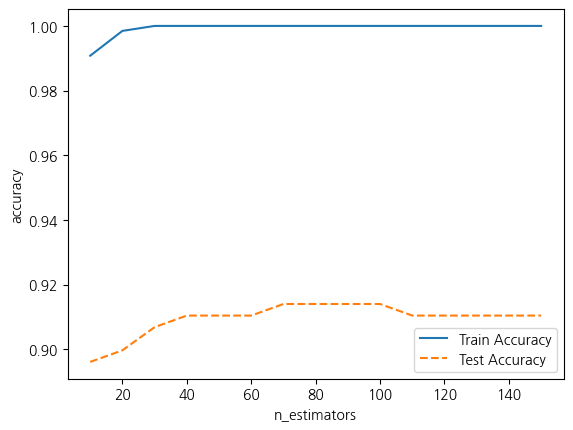

In [256]:
plt.plot(para_n_tree, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_n_tree, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.xlabel("n_estimators"); plt.ylabel("accuracy")
plt.legend()

In [257]:
oob_error = []

for v_n_estimator in range(5, 121):
    rf = RandomForestClassifier(n_estimators = v_n_estimator, oob_score = True, random_state= 1234)
    rf.fit(df_train_x, df_train_y)
    oob_error.append(1 - rf.oob_score_)

/home/piai/anaconda3/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:583: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/home/piai/anaconda3/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:583: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/home/piai/anaconda3/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:583: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/home/piai/anaconda3/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:583: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/home/piai/anaconda3/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:583: UserWarning: Some inputs 

Text(0.5, 0, 'n_estimators')

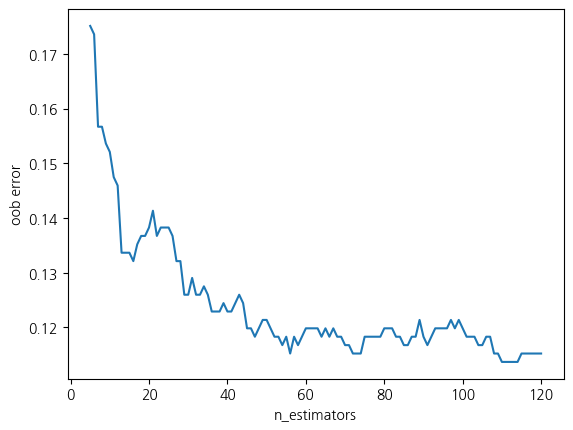

In [258]:
plt.plot(range(5, 121), oob_error)
plt.ylabel("oob error")
plt.xlabel("n_estimators")

n_estimators가 늘어남에 따라 error가 적게나마 줄어드는 걸 볼 수 있다.

In [259]:

train_accuracy = []; test_accuracy = []

para_depth = [depth for depth in range(3, 11)]

for v_max_depth in para_depth:
    rf = RandomForestClassifier(max_depth = v_max_depth, n_estimators=100, random_state=1234)
    rf.fit(df_train_x, df_train_y)
    train_accuracy.append(rf.score(df_train_x, df_train_y))
    test_accuracy.append(rf.score(df_test_x, df_test_y))


df_accuracy_depth = pd.DataFrame()
df_accuracy_depth["Depth"] = para_depth
df_accuracy_depth["TrainAccuracy"] = train_accuracy
df_accuracy_depth["TestAccuracy"] = test_accuracy


In [260]:
para_depth

[3, 4, 5, 6, 7, 8, 9, 10]

In [261]:
# 모델 정확도 확인
df_accuracy_depth.round(3)

,Depth,TrainAccuracy,TestAccuracy
0,3,0.816,0.849
1,4,0.897,0.885
2,5,0.909,0.903
3,6,0.925,0.903
4,7,0.940,0.903
5,8,0.945,0.910
6,9,0.946,0.900
7,10,0.957,0.914


Depth가 깊어짐에 따라 train/test accuracy 모두 증가하는 걸 볼 수 있다. <br>
하지만 test accuracy에 대해 기존 대비 크게 상승하지 않은 걸 확인할 수 있다.

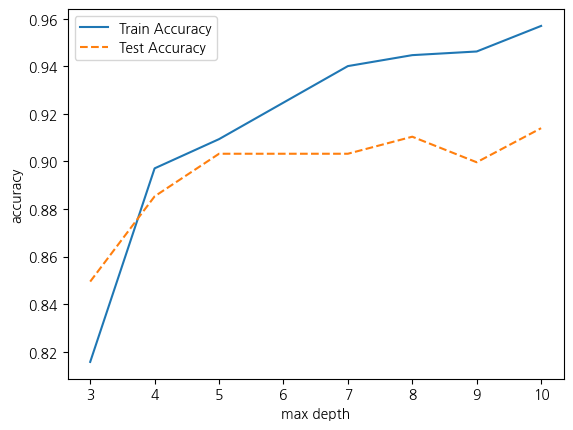

In [262]:
plt.plot(para_depth, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_depth, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.xlabel("max depth"); plt.ylabel("accuracy")
plt.legend()

train과 test의 정확도가 함께 증가하는 모습을 볼 수 있다.<br>
max depth는 그래프 상에서 적절한 깊이 값인 6으로 설정한다.

In [263]:
print("전체 자료 = ", df_train_x.shape[0],"개")
print("전체 자료의 1% = ", df_train_x.shape[0] * 0.01,"개")

전체 자료 =  651 개
전체 자료의 1% =  6.51 개


In [264]:

train_accuracy = []; test_accuracy = []

para_split = [n_split * 10 for n_split in range(1, 11)]

for v_min_samples_split in para_split:
    rf = RandomForestClassifier(min_samples_split = v_min_samples_split, max_depth=6,
                                n_estimators=100, random_state=1234)
    rf.fit(df_train_x, df_train_y)
    train_accuracy.append(rf.score(df_train_x, df_train_y))
    test_accuracy.append(rf.score(df_test_x, df_test_y))

df_accuracy_split = pd.DataFrame()
df_accuracy_split["MinSamplesSplit"] = para_split
df_accuracy_split["TrainAccuracy"] = train_accuracy
df_accuracy_split["TestAccuracy"] = test_accuracy

In [265]:
para_split

[10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

In [266]:
df_accuracy_split.round(3)

,MinSamplesSplit,TrainAccuracy,TestAccuracy
0,10,0.917,0.903
1,20,0.897,0.907
2,30,0.889,0.903
3,40,0.885,0.896
4,50,0.877,0.896
5,60,0.877,0.896
6,70,0.876,0.900
7,80,0.876,0.900
8,90,0.876,0.900
9,100,0.876,0.892


분리 노드의 최소 자료 수 증가에 따라 모델의 train 정확도가 감소하며 test 정확도가 일정하지 않은 걸 확인할 수 있다.
min samples split은 20으로 설정한다.

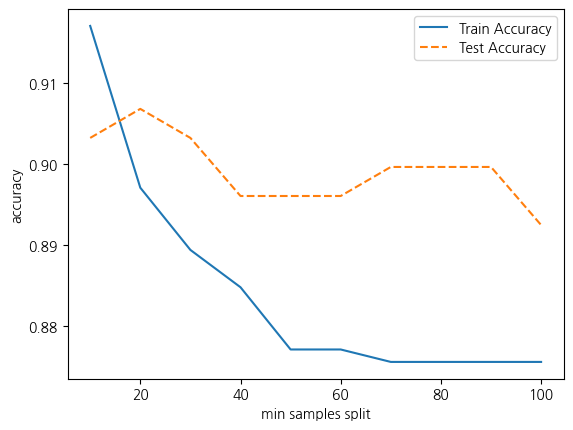

In [267]:
plt.plot(para_split, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_split, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.xlabel("min samples split"); plt.ylabel("accuracy")
plt.legend()

In [268]:

train_accuracy = []; test_accuracy = []

para_leaf = [n_leaf * 5 for n_leaf in range(1, 11)]

for v_min_samples_leaf in para_leaf:
    rf = RandomForestClassifier(min_samples_leaf = v_min_samples_leaf,
                                max_depth=6, n_estimators=100, random_state=1234)
    rf.fit(df_train_x, df_train_y)
    train_accuracy.append(rf.score(df_train_x, df_train_y))
    test_accuracy.append(rf.score(df_test_x, df_test_y))

df_accuracy_leaf = pd.DataFrame()
df_accuracy_leaf["MinSamplesLeaf"] = para_leaf
df_accuracy_leaf["TrainAccuracy"] = train_accuracy
df_accuracy_leaf["TestAccuracy"] = test_accuracy

In [269]:
para_leaf

[5, 10, 15, 20, 25, 30, 35, 40, 45, 50]

In [271]:
df_accuracy_leaf.round(3)

,MinSamplesLeaf,TrainAccuracy,TestAccuracy
0,5,0.902,0.903
1,10,0.886,0.875
2,15,0.849,0.867
3,20,0.820,0.849
4,25,0.791,0.842
5,30,0.791,0.842
6,35,0.791,0.842
7,40,0.791,0.842
8,45,0.791,0.842
9,50,0.791,0.842


Train, Test의 정확도가 모두 떨어지고 있다.<br>
train, test 변화와 자료수 고려해서 15로 설정한다.

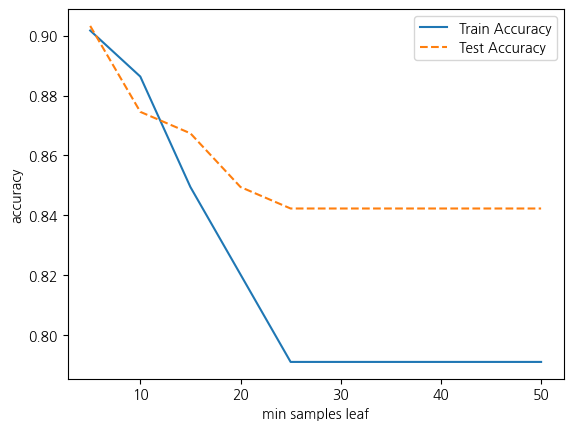

In [272]:
plt.plot(para_leaf, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_leaf, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.xlabel("min samples leaf"); plt.ylabel("accuracy")
plt.legend()

In [273]:

rf_final = RandomForestClassifier(min_samples_leaf=15, max_depth=6, n_estimators=100,
                                  random_state=1234)
rf_final.fit(df_train_x, df_train_y)

y_pred = rf_final.predict(df_test_x)


print("Accuracy on training set: {:.3f}".format(rf_final.score(df_train_x, df_train_y)))

print("Accuracy on test set: {:.3f}\n".format(rf_final.score(df_test_x, df_test_y)))

print("Confusion matrix: \n{}".format(confusion_matrix(df_test_y, y_pred)))

print(classification_report(df_test_y, y_pred, digits=3))

Accuracy on training set: 0.820
Accuracy on test set: 0.849

Confusion matrix: 
[[233   2]
 [ 40   4]]
              precision    recall  f1-score   support

           0      0.853     0.991     0.917       235
           1      0.667     0.091     0.160        44

    accuracy                          0.849       279
   macro avg      0.760     0.541     0.539       279
weighted avg      0.824     0.849     0.798       279



다른 부분들에 비해 recall과 이에 따른 f1-score가 낮으므로 이에 대한 개선이 필요할 것으로 보인다.<br>
전체 데이터에 대해 recall, f1-score 등이 낮게 나왔다. 또한 accuracy도 낮게 나온 걸 확인할 수 있다.

In [274]:

v_feature_names = df_train_x.columns
df_importance = pd.DataFrame()
df_importance ["Feature"] = v_feature_names
df_importance ["Importance"] = rf_final.feature_importances_

df_importance .sort_values("Importance", ascending=False, inplace = True)
df_importance .round(3)

,Feature,Importance
16,HANDSET_ASAD90,0.234
5,PEAK_CALLS_TIME,0.126
3,DROPPED_CALLS,0.105
9,TOTAL_CALLS_TIME,0.070
2,SERVICE_DURATION,0.066
4,PEAK_CALLS_NO,0.064
1,AGE,0.048
25,HANDSET_WC95,0.047
8,TOTAL_CALLS_NO,0.039
15,HANDSET_ASAD170,0.037


Text(0, 0.5, '설명변수')

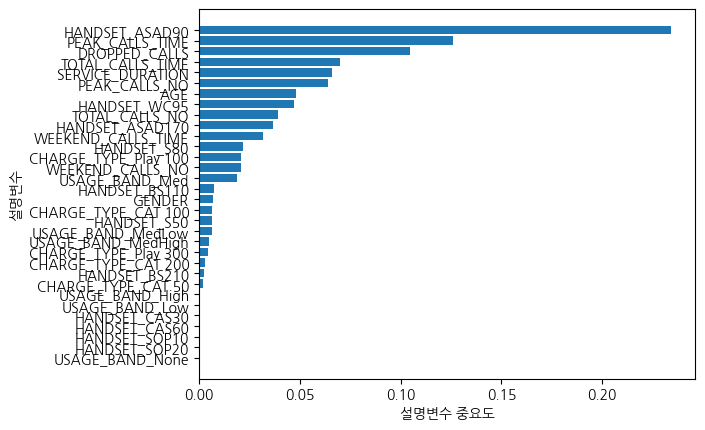

In [275]:
df_importance .sort_values("Importance", ascending=True, inplace = True)
coordinates = range(len(df_importance ))
plt.barh(y = coordinates, width = df_importance ["Importance"])
plt.yticks(coordinates, df_importance ["Feature"])
plt.xlabel("설명변수 중요도")
plt.ylabel("설명변수")

중요 설명 변수는 HANDSET_ASAD90, PEAK_CAtLS_TIME, DROPPED_CALLS가 순서 대로 중요한 변수 임을 알 수 있다. <br>
계산된 변수 중요도 값이 낮아도 훈련 데이터에 따라 중요도가 변경될 수 있다.

종합적인 성능 지표인 accuracy, recall, precision, f1-score 등을 고려했을 때 decision tree가 가장 좋은 성능을 보이는 것으로 확인된다.<br>
또한 3가지 모델의 공통점으로 HANDSET의 변수 영향도가 가장 크게 나타난 걸 확인할 수 있었다.